In [1]:
# author: Nicolai Meyerhöfer

library(DAseq)
library(rjson)
library(reticulate)
library(stringr)
pd <- import("pandas")
#' Calculates the individual differentially abundant (DA) cells and clusters for all of the given samples vs the given controls
#'
#' @param controls Dataframe of controls
#' @param patients Dataframe of patients
#' @param save_path Path to save results to
#' @param save_file_name Optional extra filename for saving DA cells and regions
#' @param remove_nrows Optional removal of rows of patient dataframe for validation
#' 


The legacy packages maptools, rgdal, and rgeos, underpinning this package
will retire shortly. Please refer to R-spatial evolution reports on
https://r-spatial.org/r/2023/05/15/evolution4.html for details.
This package is now running under evolution status 0 

Warning message:
“package ‘stringr’ was built under R version 4.2.3”


In [2]:
#' Constructs a data frame comprised of all given samples.
#'
#' @param csv_paths CSV paths of all used samples
#' @param labels Labels of samples to use in given csv files
#' @returns data frame comprised of all given samples
read_data <- function(pickle_paths) {
  df <- data.frame()  # Create an empty data frame

  for (pickle_path in pickle_paths) {
    str_list = str_split(pickle_paths, "/") 
    label = basename(pickle_path)
    pickle_data <- pd$read_pickle(pickle_path)  # Read pickle file using reticulate
    pickle_data$label <- rep(label, nrow(pickle_data))
    df <- rbind(df, pickle_data)
    }
  return(df)
}


In [3]:
calculate_DA_clusters <- function(controls, patients, save_path = "./", json_save_path = "./", save_file_name = ""){

    runFItSNE <- function(data, seed.use = 0, reduction.name = "tsne", reduction.key = "tSNE_",
                            fast.R.path = "/data_slow/je30bery/DAseq-master/FIt-SNE/fast_tsne.R", ...)
    {
        current.dir <- getwd()
        source(fast.R.path, chdir = T)
        X.out <- fftRtsne(X = data, rand_seed = seed.use, ...)
        setwd(current.dir)
        return(X.out)
    }


    ids_controls <- controls[,ncol(controls)]
    ids_patients <- patients[,ncol(patients)]
	
	for(sample_id in ids_patients[!duplicated(ids_patients)]){
        print(sample_id)
        df_patient <- patients[patients$label == sample_id,]
        df_new_tmp <- rbind(controls, df_patient)
        df_new <- df_new_tmp[,1:ncol(df_new_tmp)-1]
        df_new <- sapply(df_new, as.numeric)
        
        df.scaled <- scale(df_new[,1:ncol(df_new_tmp)-1])
        data_tsne <- runFItSNE(df.scaled)
        data_tsne.col <- ncol(data_tsne)
 
        colnames(data_tsne) <- paste("tSNE_", c(1:data_tsne.col), sep="")
        rownames(data_tsne) <- rownames(df.scaled)

        cell_labels <- as.character(df_new_tmp[, ncol(df_new_tmp)])
        print(cell_labels)
        labels_1 <- as.character(ids_patients[!duplicated(ids_patients)])
        labels_2 <- as.character(ids_controls[!duplicated(ids_controls)])

        df_scaled <- as.data.frame(df.scaled)
        

        da_cells <- getDAcells(
                X = df_scaled,
                cell.labels = cell_labels,
                labels.1 = labels_1,
                labels.2 = labels_2,
                k.vector = seq(50, 500, 50),
                plot.embedding = data_tsne
        )

        da_cells <- updateDAcells(
                X = da_cells,
                pred.thres = c(-0.8,0.8),
                do.plot = T,
                plot.embedding = data_tsne,
                size = 0.1
        )

        f <- paste(save_path, "da_cells_", save_file_name, sample_id, ".rds", sep="")
        saveRDS(da_cells, f)

        da_regions <- getDAregion(
                X = df.scaled,
                da.cells = da_cells,
                cell.labels = df_new_tmp[,ncol(df_new_tmp)],
                labels.1 = ids_patients[!duplicated(ids_patients)],
                labels.2 = ids_controls[!duplicated(ids_controls)],
                resolution = 0.01,
                min.cell = 50,
                plot.embedding = data_tsne,
                size = 0.1
        )

        f <- paste(save_path, "da_regions_", save_file_name, sample_id, ".rds", sep="")
        saveRDS(da_regions, f)

        # writing the json file
        da_cluster_name <- sample_id
        cluster_labels <- which(da_regions$DA.stat[,1] < 0)
        
        da_cluster_purities <- list(da_regions$DA.stat[cluster_labels])	
        da_cluster_cells_tmp <- list()
        da_cluster_sizes_tmp <- c()
            for(cluster_label in cluster_labels){
            cells <- which(da_regions$da.region.label == cluster_label)
            # indices -1 to fit python indices because R counts indices from 1 :D 
            for(i in 1:length(cells)){
                cells[i] <- cells[i] - 1
            }
            da_cluster_cells_tmp <- append(da_cluster_cells_tmp, list(cells))
            da_cluster_sizes_tmp <- c(da_cluster_sizes_tmp, length(cells))
        }
            da_cluster_sizes <- list(da_cluster_sizes_tmp)	
        da_cluster_cells <- list(da_cluster_cells_tmp)
        json_df <- data.frame(da_cluster_name)
        json_clusters <- data.frame(Sizes = I(da_cluster_sizes), Purities = I(da_cluster_purities), DA_Cells = I(da_cluster_cells))
        json_df$Clusters <- json_clusters
        json_file <- toJSON(json_df)
        write(json_file, file = paste(json_save_path, sample_id, "_clusters.json", sep="", collapse=NULL))
    }
}

In [7]:
labels_1

ERROR: Error in eval(expr, envir, enclos): object 'labels_1' not found


In [4]:
control_dir <- "/data_slow/je30bery/spatial_proteomics/marker_expression_nuclei_results/control"
patient_dir <- "/data_slow/je30bery/spatial_proteomics/marker_expression_nuclei_results/case"

#control_samples <- strsplit(args[3], ",")[[1]] #TODO
#patient_samples <- strsplit(args[4], ",")[[1]] #TODO

r_file_out <- "/data_slow/je30bery/spatial_proteomics/DAseq_results/"
json_file_out <- "/data_slow/je30bery/spatial_proteomics/DAseq_results/"

# Check that the directories exist
if (!file.exists(control_dir) || !file.info(control_dir)$isdir) {
    stop(paste0("Directory does not exist: ", control_dir))
}
if (!file.exists(patient_dir) || !file.info(patient_dir)$isdir) {
    stop(paste0("Directory does not exist: ", patient_dir))
}

# Get CSV filenames
control_files <- list.files(control_dir, "*.pkl", full.names=TRUE)
patient_files <- list.files(patient_dir, "*.pkl", full.names=TRUE)

# Read data
control_data <- read_data(control_files)
if (is.null(control_data)) {
    warning(paste0("No pickle files found in ", control_dir))
}
patient_data <- read_data(patient_files)
if (is.null(patient_data)) {
    warning(paste0("No pickle files found in ", patient_dir))
}

# Calculate clusters
#calculate_DA_clusters(controls = control_data, patients = patient_data,
#                       save_path = r_file_out, json_save_path = json_file_out)

[1] "ALS01 - 21297.pkl"
[1] 112426     19


FIt-SNE R wrapper loading.

FIt-SNE root directory was set to /data_slow/je30bery/DAseq-master/FIt-SNE

Using irlba() to compute the top PCs for initialization.



    [1] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
    [4] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
    [7] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [10] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [13] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [16] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [19] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [22] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [25] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [28] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [31] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [34] "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl" "Healthy01 - 21315.pkl"
   [37] "Healthy01 - 21315.pkl" "Healthy

FIt-SNE R wrapper loading.

FIt-SNE root directory was set to /data_slow/je30bery/DAseq-master/FIt-SNE

Using irlba() to compute the top PCs for initialization.



In [9]:
controls <- control_data
patients = patient_data
save_path = r_file_out
json_save_path = json_file_out
save_file_name = ""

runFItSNE <- function(data, seed.use = 0, reduction.name = "tsne", reduction.key = "tSNE_",
                        fast.R.path = "/data_slow/je30bery/DAseq-master/FIt-SNE/fast_tsne.R", ...)
{
    current.dir <- getwd()
    source(fast.R.path, chdir = T)
    X.out <- fftRtsne(X = data, rand_seed = seed.use, ...)
    setwd(current.dir)
    return(X.out)
}


ids_controls <- controls[,ncol(controls)]
ids_patients <- patients[,ncol(patients)]


In [11]:
ids_patients

[1] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
    [4] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
    [7] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [10] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [13] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [16] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [19] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [22] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [25] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [28] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [31] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [34] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [37] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [40] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [43] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [46] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [49] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [52] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [55] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [58] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [61] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [64] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [67] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [70] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [73] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [76] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [79] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [82] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [85] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [88] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [91] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [94] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
   [97] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [100] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [103] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [106] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [109] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [112] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [115] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [118] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [121] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [124] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [127] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [130] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [133] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [136] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [139] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [142] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [145] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [148] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [151] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [154] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [157] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [160] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [163] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [166] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [169] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [172] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 21297.pkl"
  [175] "ALS01 - 21297.pkl" "ALS01 - 21297.pkl" "ALS01 - 212

In [12]:
ids_patients[!duplicated(ids_patients)]

[1] "ALS01 - 21297.pkl" "ALS01 - 21298.pkl" "ALS01 - 21299.pkl"
 [4] "ALS01 - 21300.pkl" "ALS02 - 21301.pkl" "ALS02 - 21302.pkl"
 [7] "ALS02 - 21303.pkl" "ALS02 - 21304.pkl" "ALS03 - 21305.pkl"
[10] "ALS03 - 21306.pkl" "ALS03 - 21307.pkl" "ALS03 - 21308.pkl"

In [14]:
sample_id = 'ALS03 - 21306.pkl'

In [16]:
df_patient <- patients[patients$label == sample_id,]
df_new_tmp <- rbind(controls, df_patient)
df_new <- df_new_tmp[,1:ncol(df_new_tmp)-1]
df_new <- sapply(df_new, as.numeric)

df.scaled <- scale(df_new[,1:ncol(df_new_tmp)-1])
data_tsne <- runFItSNE(df.scaled)
data_tsne.col <- ncol(data_tsne)

colnames(data_tsne) <- paste("tSNE_", c(1:data_tsne.col), sep="")
rownames(data_tsne) <- rownames(df.scaled)

cell_labels <- as.character(df_new_tmp[, ncol(df_new_tmp)])
#print(cell_labels)
labels_1 <- as.character(ids_patients[!duplicated(ids_patients)])
labels_2 <- as.character(ids_controls[!duplicated(ids_controls)])

df_scaled <- as.data.frame(df.scaled)

FIt-SNE R wrapper loading.

FIt-SNE root directory was set to /data_slow/je30bery/DAseq-master/FIt-SNE

Using irlba() to compute the top PCs for initialization.



In [22]:
df_scaled

CD11b-PE,CD16-PE,CD2-FITC,CD26-PE,CD29-FITC,CD3-PE,CD36-FITC,CD38-PE,CD4-PE,CD45-PE,CD45RA-PE,CD56-PE,CD57-PE,CD7-PE,CD8-PE,HLA-DQ-FITC,HLA-DR-PE,NeuN-AF488,PBS
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
-0.50954481,-0.4200504,-0.75926326,-0.419309428,-0.51911376,-0.6786405,-0.44923574,-0.4946970,-0.61654392,-0.42342282,1.99193749,0.01775195,-0.2815760,-0.63555839,-0.4703544,1.38708269,1.76890533,-0.1860054,0.03492181
-0.50954481,-0.4200504,0.13400700,4.300460519,0.41062040,1.1996729,-0.44923574,-0.4946970,1.42299012,0.58787337,-0.65278531,-0.08720814,-0.2815760,-0.63555839,-0.4703544,-0.59311920,-0.51905817,-0.1860054,-0.23901949
-0.50954481,-0.4200504,0.09400504,-0.419309428,0.72546314,-0.2569991,-0.44923574,-0.4946970,-0.61654392,-0.81650359,-0.28756169,-0.44153496,-0.2815760,-0.51751847,1.1377380,-0.61510932,-0.52747291,-0.1860054,-0.23901949
-0.50954481,-0.4200504,1.30566674,-0.046804329,0.64696994,2.1251924,-0.17179625,-0.4946970,2.92177177,0.40906609,-0.28630230,-0.43200997,-0.2815760,0.81952956,-0.4703544,-0.71612535,-0.52747291,-0.1860054,-0.23901949
-0.50954481,-0.4200504,-0.17495041,0.957032125,-0.51911376,0.5111025,-0.44923574,-0.4946970,0.61252812,0.69674000,-0.65278531,-0.05756519,-0.2815760,0.18053648,-0.4703544,0.76744943,-0.52747291,-0.1860054,-0.23901949
-0.50954481,-0.4200504,-0.61814567,-0.255119853,-0.51911376,0.0461697,-0.44923574,-0.4946970,-0.49728448,-0.02421612,0.13517961,-0.05500010,-0.2815760,0.63114226,0.5658198,0.47263551,-0.52747291,-0.1860054,-0.23901949
-0.50954481,-0.4200504,-0.28432515,-0.419309428,-0.11562459,-0.5235769,-0.44923574,-0.4946970,-0.61654392,-0.75242151,-0.26204974,-0.38957352,-0.2815760,0.58520006,0.6716501,-0.52476304,-0.52747291,-0.1860054,-0.23901949
-0.50954481,-0.4200504,-0.64490800,0.272972001,-0.51911376,-0.6786405,-0.44923574,-0.4946970,-0.61654392,-0.77938620,-0.61532538,-0.20438728,-0.2815760,-0.63555839,-0.4634820,1.49923026,2.08794873,-0.1860054,-0.21890039
-0.50954481,1.5987776,-0.83382068,-0.419309428,0.37183797,-0.6786405,-0.44923574,-0.4946970,-0.61654392,-0.35019417,-0.65278531,-0.34416182,-0.2815760,-0.63555839,-0.4703544,0.35917673,0.09636674,-0.1860054,-0.23901949


In [23]:
da_cells <- getDAcells(
        X = df_scaled,
        cell.labels = cell_labels,
        labels.1 = labels_1,
        labels.2 = labels_2,
        k.vector = seq(50, 500, 50),
        plot.embedding = data_tsne
)

Turning X to a matrix.
Calculating DA score vector.
Running GLM.
Test on random labels.
Setting thresholds based on permutation


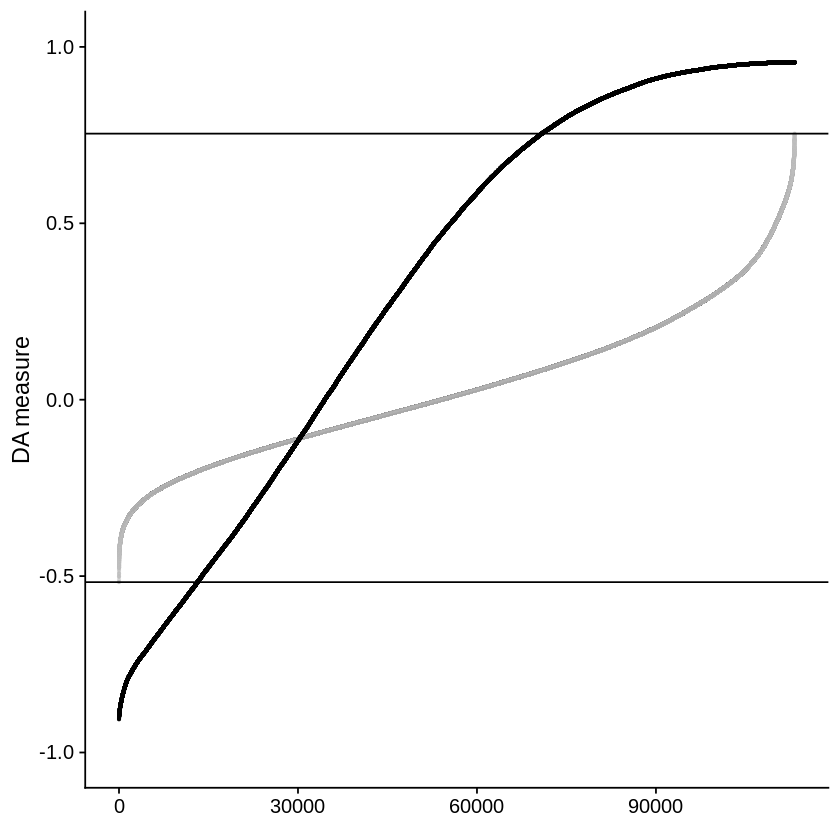

$cell.idx
    [1]     1     2     3     4     5     6     7     8     9    10    11    12
   [13]    13    14    15    16    17    18    19    20    21    22    23    24
   [25]    25    26    27    28    29    30    31    32    33    34    35    36
   [37]    37    38    39    40    41    42    43    44    45    46    47    48
   [49]    49    50    51    52    53    54    55    56    57    58    59    60
   [61]    61    62    63    64    65    66    67    68    69    70    71    72
   [73]    73    74    75    76    77    78    79    80    81    82    83    84
   [85]    85    86    87    88    89    90    91    92    93    94    95    96
   [97]    97    98    99   100   101   102   103   104   105   106   107   108
  [109]   109   110   111   112   113   114   115   116   117   118   119   120
  [121]   121   122   123   124   125   126   127   128   129   130   131   132
  [133]   133   134   135   136   137   138   139   140   141   142   143   144
  [145]   145   146   147   14

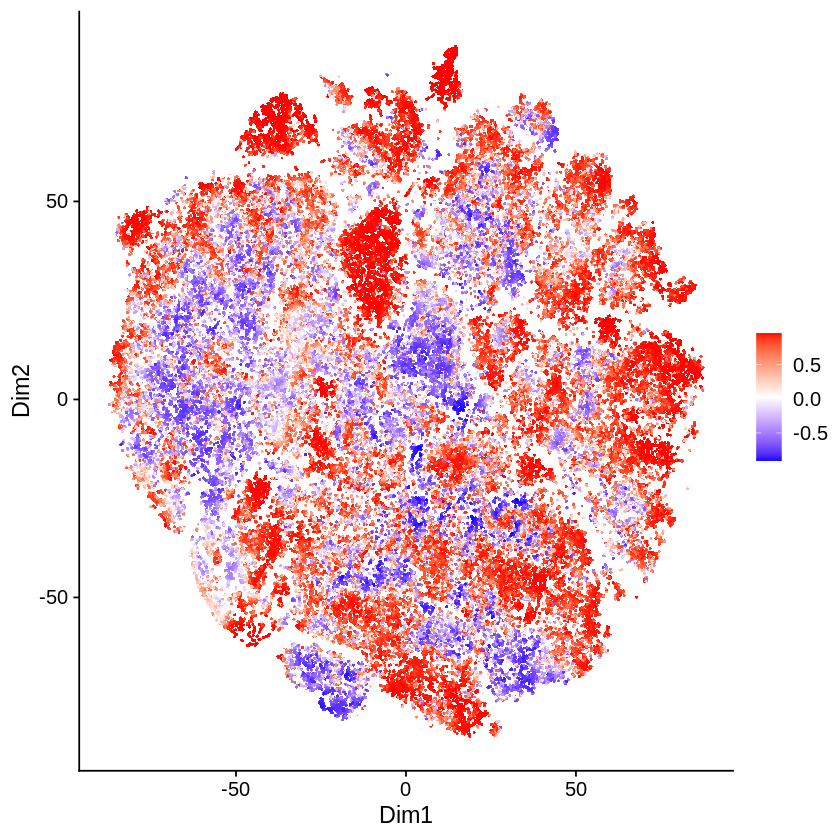

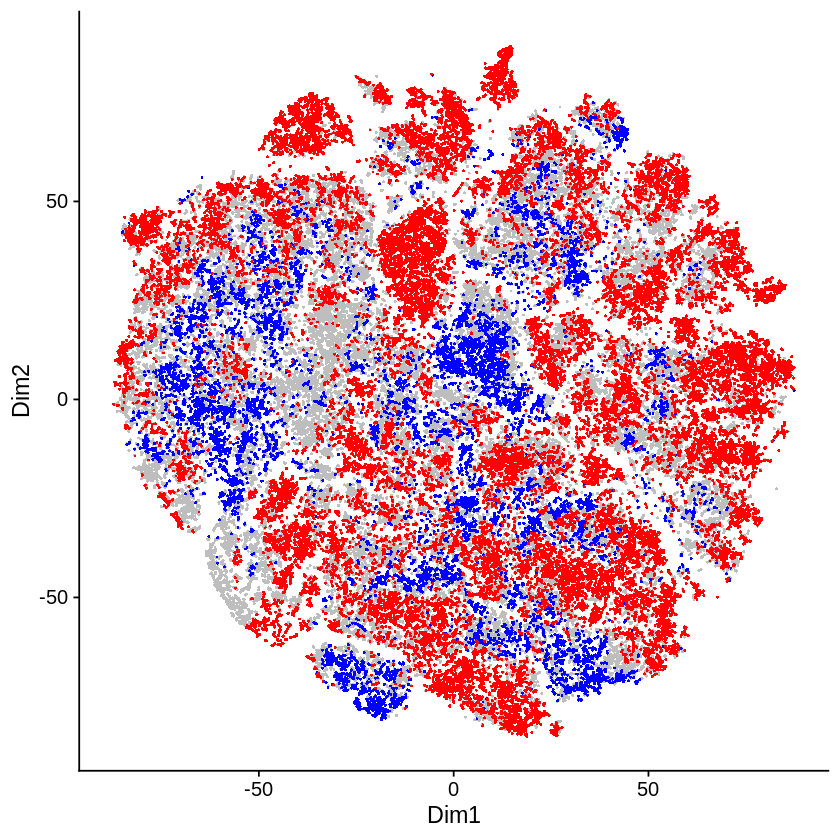

In [24]:
da_cells

In [25]:
da_cells <- updateDAcells(
        X = da_cells,
        pred.thres = c(-0.8,0.8),
        do.plot = T,
        plot.embedding = data_tsne,
        size = 0.1
)

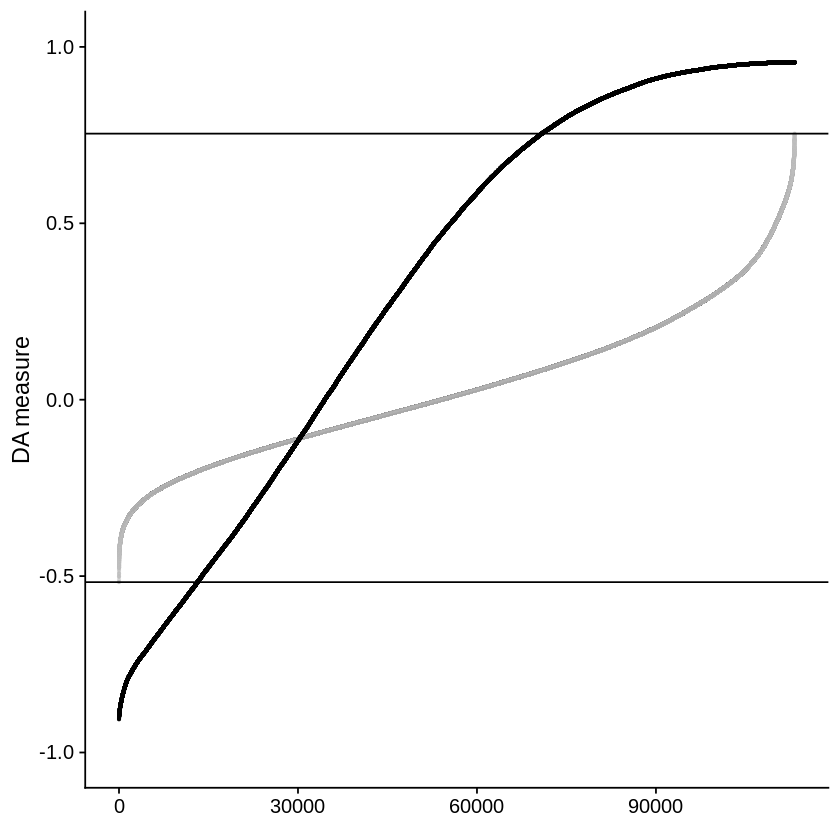

$cell.idx
    [1]     1     2     3     4     5     6     7     8     9    10    11    12
   [13]    13    14    15    16    17    18    19    20    21    22    23    24
   [25]    25    26    27    28    29    30    31    32    33    34    35    36
   [37]    37    38    39    40    41    42    43    44    45    46    47    48
   [49]    49    50    51    52    53    54    55    56    57    58    59    60
   [61]    61    62    63    64    65    66    67    68    69    70    71    72
   [73]    73    74    75    76    77    78    79    80    81    82    83    84
   [85]    85    86    87    88    89    90    91    92    93    94    95    96
   [97]    97    98    99   100   101   102   103   104   105   106   107   108
  [109]   109   110   111   112   113   114   115   116   117   118   119   120
  [121]   121   122   123   124   125   126   127   128   129   130   131   132
  [133]   133   134   135   136   137   138   139   140   141   142   143   144
  [145]   145   146   147   14

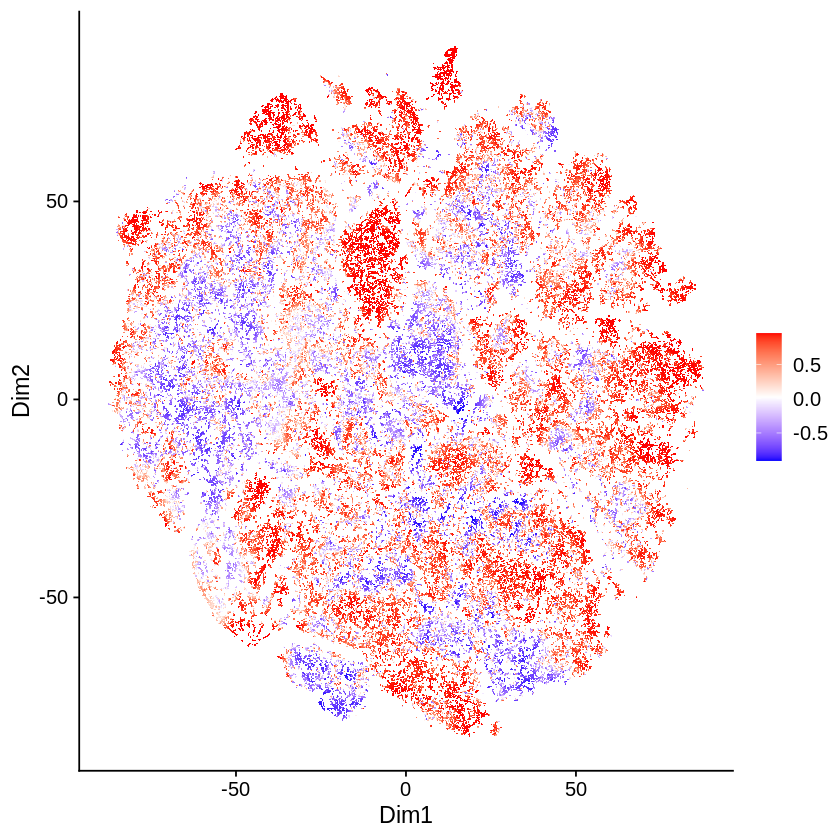

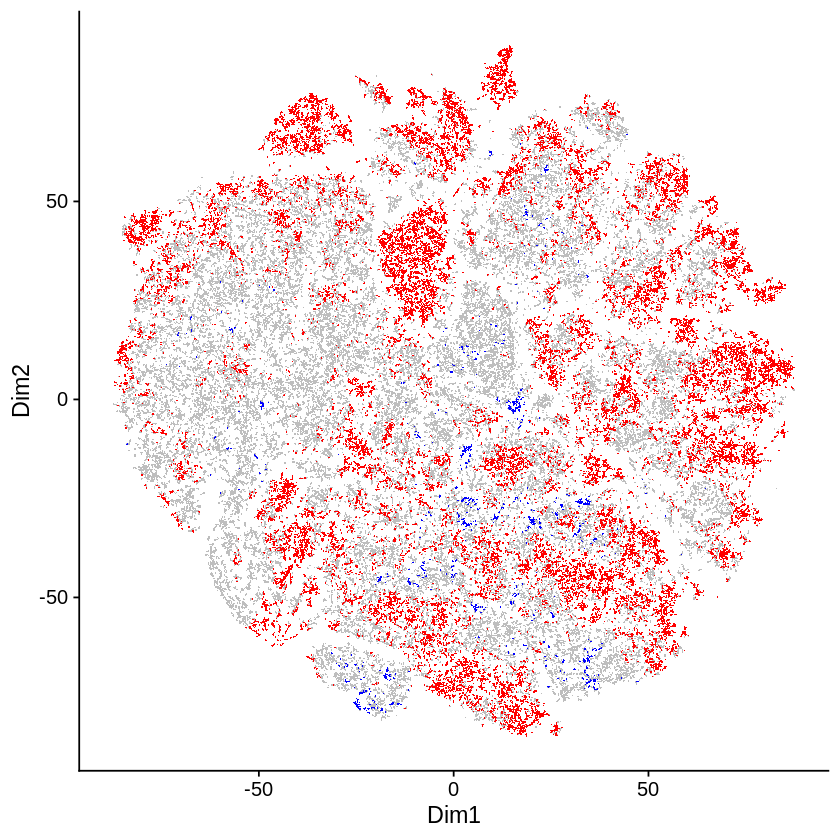

In [26]:
da_cells

In [ ]:
f <- paste(save_path, "da_cells_", save_file_name, sample_id, ".rds", sep="")
saveRDS(da_cells, f)

da_regions <- getDAregion(
        X = df.scaled,
        da.cells = da_cells,
        cell.labels = df_new_tmp[,ncol(df_new_tmp)],
        labels.1 = ids_patients[!duplicated(ids_patients)],
        labels.2 = ids_controls[!duplicated(ids_controls)],
        resolution = 0.01,
        min.cell = 50,
        plot.embedding = data_tsne,
        size = 0.1
)

In [ ]:

f <- paste(save_path, "da_regions_", save_file_name, sample_id, ".rds", sep="")
saveRDS(da_regions, f)


In [ ]:

# writing the json file
da_cluster_name <- sample_id
cluster_labels <- which(da_regions$DA.stat[,1] < 0)

da_cluster_purities <- list(da_regions$DA.stat[cluster_labels])	
da_cluster_cells_tmp <- list()
da_cluster_sizes_tmp <- c()
    for(cluster_label in cluster_labels){
    cells <- which(da_regions$da.region.label == cluster_label)
    # indices -1 to fit python indices because R counts indices from 1 :D 
    for(i in 1:length(cells)){
        cells[i] <- cells[i] - 1
    }
    da_cluster_cells_tmp <- append(da_cluster_cells_tmp, list(cells))
    da_cluster_sizes_tmp <- c(da_cluster_sizes_tmp, length(cells))
}
    da_cluster_sizes <- list(da_cluster_sizes_tmp)	
da_cluster_cells <- list(da_cluster_cells_tmp)
json_df <- data.frame(da_cluster_name)
json_clusters <- data.frame(Sizes = I(da_cluster_sizes), Purities = I(da_cluster_purities), DA_Cells = I(da_cluster_cells))
json_df$Clusters <- json_clusters
json_file <- toJSON(json_df)
write(json_file, file = paste(json_save_path, sample_id, "_clusters.json", sep="", collapse=NULL))